In [1]:
import os, sys
import h5py
import numpy as np
import scipy as sp
from astropy import constants as const
import matplotlib.pyplot as plt
import units as un
from skimage.measure import block_reduce
import plotly.graph_objects as go
from analyze3d import data

import yt
from yt.funcs import mylog
mylog.setLevel(40)

%matplotlib notebook
%matplotlib inline

/u/lgaertner/miniconda3/lib/python3.9/_collections_abc.py:684: MatplotlibDeprecationWarning: The global colormaps dictionary is no longer considered public API.
  self[key]


In [2]:
os.chdir("/u/lgaertner/RUN_DIR/")
%run ~/CODE_DIR/athena/vis/python/plot_mesh.py -i mesh_structure.dat -o mesh.png

In [3]:
os.chdir("/u/lgaertner/RUN_DIR/outputSMR3D/")
#os.chdir("/u/lgaertner/RUN_DIR/outputSMR/")
print(os.getcwd())

/ccas/u/lgaertner/RUN_DIR/outputSMR3D


### Check file content

In [4]:
hdf5files = np.sort([f for f in os.listdir(os.getcwd()) if f.endswith(".athdf") and f.startswith("cbd.out1")])
print(hdf5files)
for f in hdf5files:
    print(f)
    file = h5py.File(f, "r")
    print(file.keys())
    print(file["prim"])
    break

['cbd.out1.00000.athdf' 'cbd.out1.00001.athdf' 'cbd.out1.00002.athdf'
 'cbd.out1.00003.athdf' 'cbd.out1.00004.athdf' 'cbd.out1.00005.athdf'
 'cbd.out1.00006.athdf' 'cbd.out1.00007.athdf' 'cbd.out1.00008.athdf'
 'cbd.out1.00009.athdf' 'cbd.out1.00010.athdf']
cbd.out1.00000.athdf
<KeysViewHDF5 ['Levels', 'LogicalLocations', 'prim', 'x1f', 'x1v', 'x2f', 'x2v', 'x3f', 'x3v']>
<HDF5 dataset "prim": shape (5, 120, 16, 32, 32), type "<f4">


In [5]:
file = h5py.File('cbd.out1.00000.athdf', "r")
print(file.keys())
for key in file.keys():
    print(key, file[key])

<KeysViewHDF5 ['Levels', 'LogicalLocations', 'prim', 'x1f', 'x1v', 'x2f', 'x2v', 'x3f', 'x3v']>
Levels <HDF5 dataset "Levels": shape (120,), type ">i4">
LogicalLocations <HDF5 dataset "LogicalLocations": shape (120, 3), type ">i8">
prim <HDF5 dataset "prim": shape (5, 120, 16, 32, 32), type "<f4">
x1f <HDF5 dataset "x1f": shape (120, 33), type "<f4">
x1v <HDF5 dataset "x1v": shape (120, 32), type "<f4">
x2f <HDF5 dataset "x2f": shape (120, 33), type "<f4">
x2v <HDF5 dataset "x2v": shape (120, 32), type "<f4">
x3f <HDF5 dataset "x3f": shape (120, 17), type "<f4">
x3v <HDF5 dataset "x3v": shape (120, 16), type "<f4">


### Analyse and plot data

In [6]:
#Define the units
mbin = 3. #M_sun
abin = 50. #AU
u = un.units(mbin, abin)

In [138]:
class data:
    """
    Class to load, analyse and plot HDF5 data
    """
    def __init__(self, prim_files):
        self.prim_files = prim_files
        
        self.rho = []
        self.press = []
        self.v = []
        self.v1 = []
        self.v2 = []
        self.v3 = []
        #self.temp = []
        self.x1s = []
        self.x2s = []
        self.x3s = []
        self.x1p = []
        self.x2p = []
        self.x3p = []
        self.load()
        
        self.v = np.sqrt(np.array(self.v1)**2+np.array(self.v2)**2+np.array(self.v3)**2)
        
        print(np.shape(self.rho), np.shape(self.v))
        
        self.tonp()
        #self.temp = self.press/u.presref / (self.rho/u.densref) * u.tempref
        
        self.phi = np.zeros(np.shape(self.rho[0,:,:]))
        self.vr = np.array([])
        self.vphi = np.array([])
        #self.polar_vel()
        
    
    def load(self):
        unit_base= {"length_unit":(u.abin,"AU"), "time_unit":(u.tbin,"s"), "mass_unit":(u.mbin,"Msun")}
        for fprim in self.prim_files:
            print(fprim)
            ds_prim = yt.load(fprim, units_override = unit_base)
            all_data_level_1_prim = ds_prim.covering_grid(level=1, \
                                            left_edge=ds_prim.domain_left_edge, dims=ds_prim.domain_dimensions * 2)
            rho = all_data_level_1_prim["rho"].in_units("g/cm**3").to_ndarray() # rho is a NumPy array
            #press = all_data_level_1_prim["press"].in_units("g/(cm*s**2)").to_ndarray()
            v1 = all_data_level_1_prim["vel1"].in_units("km/s").to_ndarray()
            v2 = all_data_level_1_prim["vel2"].in_units("km/s").to_ndarray()
            v3 = all_data_level_1_prim["vel3"].in_units("km/s").to_ndarray()
            print(ds_prim.field_list)
            self.rho.append(rho)
            #self.press.append(press)
            self.v1.append(v1)
            self.v2.append(v2)
            self.v3.append(v3)            
        #self.load_sink()
        
    def load_sink(self):
        #sink paticle positions
        binary_orbit = np.loadtxt('/u/lgaertner/RUN_DIR/binary_orbit.tab')
        self.x1s = binary_orbit[:,4]
        self.x2s = binary_orbit[:,5]
        self.x3s = binary_orbit[:,6]
        self.x1p = binary_orbit[:,7]
        self.x2p = binary_orbit[:,8]
        self.x3p = binary_orbit[:,9]
        
        self.x1s = np.array(self.x1s)
        self.x2s = np.array(self.x2s)
        self.x3s = np.array(self.x3s)
        self.x1p = np.array(self.x1p)
        self.x2p = np.array(self.x2p)
        self.x3p = np.array(self.x3p)
        
    def tonp(self):
        #self.rho = np.array(self.rho)[:,:,:,0]
        self.rho = np.array([r for r in self.rho])
        #self.press = np.array(self.press)[:,:,:,0]
        #self.press = np.array([r for r in self.press])
        #self.v = np.array(self.v)[:,:,:,0]
        self.v = np.array([v for v in self.v])
        #self.v1 = np.array(self.v1)[:,:,:,0]
        self.v1 = np.array([v for v in self.v1])
        #self.v2 = np.array(self.v2)[:,:,:,0]
        self.v2 = np.array([v for v in self.v2])
        #self.v3 = np.array(self.v3)[:,:,:,0]
        self.v3 = np.array([v for v in self.v3])
        #self.temp = np.array(self.temp)[:,:,:,0]
        #self.temp = np.array([v.T for v in self.v3])
            
    def plot(self, simdata, fname, lab="", height = []):
        if not height:
            height = np.array([np.min(simdata), np.max(simdata)])
        #mean = np.mean(simdata)
        for filename, data in zip(self.prim_files, simdata):
            #mean = np.mean(data)
            path = os.path.join(os.getcwd(), 'plots/'+ filename.replace(".athdf", fname))
            
            reduced = block_reduce(data, block_size=(4, 4, 4), func=np.mean)
            
            X, Y, Z = np.mgrid[-10:10:64j, -10:10:64j, -5:5:32j]

            fig = go.Figure(data=go.Volume(
                x=X.flatten(),
                y=Y.flatten(),
                z=Z.flatten(),
                value=reduced.flatten(),
                isomin=1e-14,
                #isomax=1e-11,
                opacity=0.3, # needs to be small to see through all surfaces
                surface_count=15, # needs to be a large number for good volume rendering
                ))
            #fig.update_layout(scene_camera = dict(
            #    up=dict(x=1, y=0, z=0),
            #    center=dict(x=0, y=0, z=0),
            #    eye=dict(x=1.5, y=1.5, z=1.5)
            #))

            fig.write_image(path)
            print(filename)
    
    def polar_vel(self):
        #decompose velocity in radial and azimuthal parts
        
        #compute polar angle on mesh
        l = np.shape(self.phi)[0]
        X = np.array([[i-l/2+1./2 for i in range(l)] for j in range(l)])
        Y = X.T
        
        self.phi = np.arctan2(Y,X)
        
        #compute polar velocity
        self.vr   = self.v1*np.cos(self.phi) + self.v2*np.sin(self.phi)
        self.vphi = -self.v1*np.sin(self.phi) + self.v2*np.cos(self.phi)
    
    def column_dens(self, scale):
        frame = u.abin * 10
        lim = u.abin * 10.*scale
        for filename, data in zip(self.prim_files, self.rho):
            column = block_reduce(data, block_size=(1, 1, 128), func=np.mean)[:,:,0]
            print(np.shape(column))
            height = np.array([np.min(column), np.max(column)])
            
            path = os.path.join(os.getcwd(), 'plots/column/'+ filename.replace(".athdf", "_rho.png"))
            fig = plt.figure(figsize=(10,10))
            cmap="plasma"
            ax = fig.add_subplot(111)
            pos = ax.imshow(column, cmap=cmap, vmin=height[0], vmax=height[1], origin='lower', \
                            extent=[-frame,frame,-frame,frame])
            fig.colorbar(pos, ax=ax, label="$\Sigma ~[g/cm^3]$")

            ax.set_aspect('equal', 'box')
            ax.set_xlabel("$x_0~[AU]$")
            ax.set_ylabel("$x_1~[AU]$")
            ax.set_xlim(-lim, lim)
            ax.set_ylim(-lim, lim)

            plt.savefig(path)
            plt.close()
            print(filename)

In [139]:
os.chdir("/u/lgaertner/RUN_DIR/outputSMR3D/isothermal")
#os.chdir("/u/lgaertner/RUN_DIR/outputSMR/")
#unit_sys = yt.UnitSystem("disk","20.*AU", "Msun", "Myr")
#yt.unit_system_registry["disk"]
prim = np.sort([f for f in os.listdir(os.getcwd()) if f.endswith(".athdf") and f.startswith("cbd.out1")])
dat = data(prim)

cbd.out1.00000.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
cbd.out1.00001.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
cbd.out1.00002.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
cbd.out1.00003.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
cbd.out1.00004.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
cbd.out1.00005.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
cbd.out1.00006.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
cbd.out1.00007.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
cbd.out1.00008.athdf
[('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athe

In [140]:
#dat.plot(dat.rho, "_rho.png", lab="$\Sigma ~[g/cm^3]$")
dat.column_dens(1.)

(256, 256)
cbd.out1.00000.athdf
(256, 256)
cbd.out1.00001.athdf
(256, 256)
cbd.out1.00002.athdf
(256, 256)
cbd.out1.00003.athdf
(256, 256)
cbd.out1.00004.athdf
(256, 256)
cbd.out1.00005.athdf
(256, 256)
cbd.out1.00006.athdf
(256, 256)
cbd.out1.00007.athdf
(256, 256)
cbd.out1.00008.athdf
(256, 256)
cbd.out1.00009.athdf
(256, 256)
cbd.out1.00010.athdf


In [95]:
print(np.shape(dat.rho))

(1, 128, 256, 256)


In [22]:
print(dat.rho.max(), dat.rho.min(), np.mean(dat.rho))

4.939890660969464e-12 1.425417946907699e-17 6.518188546612535e-13


In [103]:
print(np.shape(dat.rho[0]))
reduced = block_reduce(dat.rho[0], block_size=(4, 4, 4), func=np.mean)
print(np.shape(reduced))

(256, 256, 128)
(64, 64, 32)


In [43]:
import plotly.graph_objects as go
import numpy as np
X, Y, Z = np.mgrid[-10:10:64j, -10:10:64j, -5:5:32j]
print(np.shape(reduced))

fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=reduced.flatten(),
    isomin=1e-14,
    isomax=1e-12,
    opacity=0.3, # needs to be small to see through all surfaces
    surface_count=15, # needs to be a large number for good volume rendering
    ))
fig.update_layout(scene_camera = dict(
    up=dict(x=1, y=0, z=0),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.5, y=1.5, z=1.5)
))

fig.show()
#fig.write_image("fig1.png")

(32, 64, 64)
6.518188546612534e-13 1.259742115130228e-12


(256, 256, 128)
(256, 256)


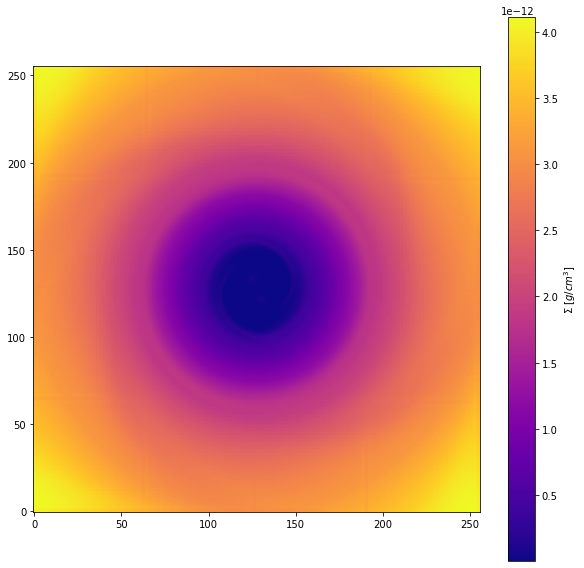

In [129]:
%matplotlib notebook
%matplotlib inline

column = block_reduce(dat.rho[5], block_size=(1, 1, 128), func=np.mean)[:,:,0]
print(np.shape(dat.rho[0]))
print(np.shape(column))
fig = plt.figure(figsize=(10,10))
cmap="plasma"
ax = fig.add_subplot(111)
pos = ax.imshow(column, cmap=cmap, origin='lower')
fig.colorbar(pos, ax=ax, label="$\Sigma ~[g/cm^3]$")

ax.set_aspect('equal', 'box')


plt.show()

### Disk Mass

In [ ]:
mtot = []
print(np.shape(dat.rho))
r = dat.rho[0,int(512/5.):,0] #g/cm^3
print(np.shape(r))
dx = 20./512. * 50.*const.au.to('cm')
dy = 20./512. * 50.*const.au.to('cm')
dz = 1. * 2.*const.au.to('cm')
print(np.mean(r))
mtot.append(np.sum(r))
mav = np.mean(mtot)*dx*dy*dz/(dat.mbin*const.M_sun.to('g'))
print(mav.value)

### Initial velocity  and density profile

In [ ]:
def vel(rad):
    gm0             = 1.0        #binary mass
    semia           = 1.0        #binary semiaxis
    rsoft           = 0.1*semia  #?
    z               = 0.0        #height
    qrat            = 1.0        #mass ratio (secondary/primary)
    pslope          = -1.0       #?
    dslope          = -0.5       #parameter -p in paper
    p0_over_r0      = 0.01       #squared sound
    p_over_r        = p0_over_r0
    gamma_gas       = 1.0001
    alpha           = 0.1
    
    rad1 = np.sqrt((rad)**2+(rsoft)**2);
    rad2 = np.sqrt((rad)**2+(rsoft)**2+(z)**2);
    qrpl = 0.75*(semia/rad1)**2*qrat/(1.0+qrat)**2;
    vel = np.sqrt((dslope+pslope)*p_over_r + gm0*(rad/rad1)**2/rad1*(1.0+qrpl)+pslope*gm0*(1.0/rad1 -1.0/rad2))
    
    # correct with radial drift due to accretion
    vel_corr = vel- 1.5*p_over_r*gamma_gas*alpha/np.sqrt(gm0/np.sqrt((rad)**2+(rsoft)**2))

    return vel, vel_corr

def density(rad):
    rho0            = 1.0         #from paper
    dslope          = -0.5        #parameter -p in paper
    p0_over_r0      = 0.01        #squared sound speed
    p_over_r        = p0_over_r0
    gm0             = 1.0         #binary mass
    semia           = 1.0         #binary semiaxis
    r0              = semia       #as in paper
    z               = 0.0         #height
    rsoft           = 0.1*semia   #?
    rin             = 2.5         #from input file, R_s in paper
    
    denmid = rho0*(rad/r0)**dslope
    denmid *= np.exp(-(rad/rin)**(-2.0))
    dentem = denmid*np.exp(gm0/p_over_r*(1./np.sqrt((rad)**2+(rsoft)**2+(z)**2)-1./np.sqrt((rad)**2+(rsoft)**2)));
    den = dentem
    return den

In [ ]:
%matplotlib notebook
%matplotlib inline
r = np.linspace(1,10,1000) #computation only out to 10a
plt.plot(r*50.,density(r)*u.densref)
plt.ylabel(r"$\rho_0~[g/cm^3]$")
plt.xlabel("$r~[AU]$")
plt.title("Initial Density Profile")
plt.show()

In [ ]:

%matplotlib notebook
%matplotlib inline
r = np.linspace(1,10,1000) #computation only out to 10a
v, v_corr = vel(r)
plt.plot(r,v, r, v_corr)
plt.ylabel("$v_0$")
plt.xlabel("$R$")
plt.legend(['initial velocity', '+accretion correction'])
plt.show()

In [ ]:

%matplotlib notebook
%matplotlib inline
l = np.shape(dat.rho[0])[0]
rad = np.zeros((l,l))
for i in range(l):
    for j in range(l):
        x = (20.*i/l-10.)
        y = (20.*j/l-10.)
        rad[i,j] = np.sqrt(x**2+y**2)
x = rad.flatten()

q= np.linspace(-10, 10, l)
grid = np.meshgrid(q,q)
rad = np.sqrt(grid[0]**2+grid[1]**2)
x = rad.flatten()*u.abin

R = dat.rho.flatten()/u.densref
P = dat.press.flatten()/u.presref
T = dat.temp.flatten()

r = np.linspace(0.01,14,1000) #computation only out to 10a
rho = density(r)#*densref

plt.loglog(x,R, 'r.')
plt.loglog(x,P, 'g.')
#plt.loglog(x,T, 'b.')
#ax.plot(x,P/R)
plt.loglog(r*u.abin,rho)


plt.xlim([1e1,1e3])
plt.ylim([1e-12,1e3])
plt.ylabel(r"$[code units]$")
plt.xlabel("$r~[AU]$")
plt.legend([r"$\rho$", r"$P$", r"$\rho$ Profile"])

plt.show()

#plt.plot(x,P, 'g.')
plt.plot(x,T, 'b.')

plt.xlim([0,400])
plt.ylabel(r"$T[K]$")
plt.xlabel("$r~[AU]$")

plt.show()

### Initial temperature profile

In [ ]:
# Compute initial temp profile

def TempProfileCyl(den0):
    T0 = 15.0 #K
    temp=0
    if(den0*u.densref<1.e-12):
        temp = T0+1.5*1.e13*den0*u.densref
    elif (1.e-12 <= den0*u.densref and den0*u.densref <= 1.e-11):
        temp = (T0+15.)*(den0*u.densref*1.e12)**0.6
    elif (1.e-11 < den0*u.densref and den0*u.densref <= 3.e-9):
        temp = 10**0.6*(T0+15.)*(den0*u.densref*1.e11)**0.44
    return temp


In [ ]:
dens = np.logspace(-16, -9, 1000)
tem = [TempProfileCyl(d/u.densref) for d in dens]
plt.loglog(dens, tem, "-")
plt.xlabel(r'$\rho ~[g/cm^3]$')
plt.ylabel(r'$T ~[K]$')
plt.show()

In [ ]:

%matplotlib notebook
%matplotlib inline
q=np.linspace(-10, 10, l)
grid = np.meshgrid(q,q)
rad = np.sqrt(grid[0]**2+grid[1]**2)
ra = rad.flatten()

x = []
y = []
for d, t, r in zip(dat.rho[0].flatten(), dat.temp[0].flatten(), rad.flatten()):
    if r > 0:
        x.append(d)
        y.append(t)
plt.loglog(x,y, ".")
plt.xlabel(r'$\rho ~[g/cm^3]$')
plt.ylabel(r'$T ~[K]$')
plt.ylim(10, 3e2)
dens = np.logspace(-17, -11, 1000)
tem = [TempProfileCyl(d/u.densref) for d in dens]
plt.loglog(dens, tem, "-")
plt.legend([r"data", r"model"])
plt.show()

### Find Flooring

In [ ]:
#self.temp = self.press / self.rho * mass_H * mu/k_B
dfloor = 1.e-6
T0 = 15.
pfloor = T0 /u.tempref*dfloor
print(pfloor)